# **Hungry For A Good Chinese Place**

* [Introduction](#introduction)
* [Methodology](#introduction)
* [Data Collection](#data-collection)
  * [Town List](#town-list)
  * [Population Density](#population-density)
  * [Restaurant List](#restaurant-list)
* [Data Analysis](#data-analysis)
  * [Plotting Point of Interest (POI)](#plotting-poi)
  * [Clustering Restaurants Near POI](#clusting-restaurants)
  * [Visualizing The Clusters](#visualizing-clusters)
* [Results and Discussion](#results)

# Introduction <a name="introduction"></a>

"Where is a good place to start a restaurant?"

When it comes to real estate, many would agree that location is key. This is especially true when we are talking about buying a commercial lot to venture into a localized business such as a restaurant. In this project we will try to find an optimal location for a restaurant or more specifically, a **Chinese restaurant** in **Selangor, Malaysia**.

Our task is to uncover potential locations **that are not overcrowded with Chinese restaurants**. We are also particularly interested in **areas with high density of population but fewer choices of restaurants** because that would translates to more potential customers. These shortlisted locations will then be proposed as a starting point for final 'street level' exploration where stakeholder can look into the nitty-gritty details before making a final decision.

# Methodology <a name="methodology"></a>

The first step in our analysis will be to identify our data requirement. Based on definition of our problem, factors that will influence our decision are as follows. We will be using a combination of **web scraper**, **Google API**, **Foursquare API** to collect these data. 
* ratio of Chinese restaurants to other type of restaurants.
* total number of existing restaurants in each town.
* population density

After that, we will want to determine the primary restaurant type in each town. The idea is to avoid towns that already have an oversupply of Chinese restaurant. We will be grouping the towns into clusters using **k-means clustering**.

Finally, we will present a **Choropleth map** that showcase each town by their density, restaurant type and population density. Stakeholders will be able to use this map to narrow down on potential towns to open their Chinese restaurant.

# Data Collection <a name="data-collection"></a>

Following data sources will be needed to extract/generate the required information:
* **list of towns in Selangor** and their respective coordinates. These can be obtained from postal code database that are publicly available. We will then convert these postal codes into coordinates using Google Maps API geocoding so we can plot them on a map.
* **population density of Selangor's district** can be obtained by scraping Wikipedia's table.
* **list of restaurants in Selangor**. We will use Foursquare API to query the restaurants near our towns in Selangor. We will need the number of restaurant, their cuisine type, and coordinates.

To begin our data collection, we're going to import all the following libraries.

In [ ]:
import numpy as np
import requests
import json
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
import folium

!pip install -U googlemaps
import googlemaps

from sklearn.cluster import KMeans

from bs4 import BeautifulSoup

print('Libraries imported.')

Requirement already up-to-date: googlemaps in /usr/local/lib/python3.6/dist-packages (4.4.2)
Libraries imported.


## Town List <a name="town-list"></a>

The first thing we need is the list of town in Selangor and their respective coordinates. This will serve as the point of interests for our study.

The list of towns in Selangor can be obtained from postal code database that are publicly available at https://mys.postcodebase.com/region1-region2/Selangor. These postal codes can then be converted into coordinates using Google Maps API geocoding.

In [ ]:
town_raw = pd.read_csv(r'Postal_Code_Selangor.csv')

print(town_raw)

       State        District                   Town  Postal_Code
0   Selangor  Kuala Selangor         Tanjong Karang        45500
1   Selangor    Kuala Langat          Tanjong Sepat        42800
2   Selangor    Kuala Langat  Telok Panglima Garang        42500
3   Selangor     Hulu Langat              UKM Bangi        43600
4   Selangor          Sepang            UPM Serdang        43400
5   Selangor          Sepang                 Sepang        43900
6   Selangor   Hulu Selangor               Serendah        48200
7   Selangor        Petaling         Seri Kembangan        43300
8   Selangor        Petaling              Shah Alam        40000
9   Selangor        Petaling         Subang Airport        47200
10  Selangor        Petaling            Subang Jaya        47600
11  Selangor    Sabak Bernam      Sungai Ayer Tawar        45100
12  Selangor    Sabak Bernam           Sungai Besar        45300
13  Selangor        Petaling           Sungai Buloh        47000
14  Selangor          Sep

Then, we will be retrieving the coordinate for each town using Google's Geocoding API service.

In [ ]:
api_key = ''    # Removed for sharing
gmaps = googlemaps.Client(key=api_key)

lat_array = []
lng_array = []

print('Processing geocoding... This will take one to two minutes to complete.')

for ind in town_raw.index:
  query = str(town_raw['Postal_Code'][ind]) + ' ' + str(town_raw['Town'][ind]) + ', Malaysia'
  results = gmaps.geocode(query)
  lat_array.append(results[0]['geometry']['location']['lat'])
  lng_array.append(results[0]['geometry']['location']['lng'])

print('Geocoding done!')

df_coord = pd.DataFrame({'Latitude':lat_array, 'Longitude':lng_array})
df_town = pd.concat([town_raw, df_coord], axis=1)
print(df_town)

Processing geocoding... This will take one to two minutes to complete.
Geocoding done!
       State        District                   Town  Postal_Code  Latitude  \
0   Selangor  Kuala Selangor         Tanjong Karang        45500  3.426409   
1   Selangor    Kuala Langat          Tanjong Sepat        42800  2.702327   
2   Selangor    Kuala Langat  Telok Panglima Garang        42500  2.922910   
3   Selangor     Hulu Langat              UKM Bangi        43600  2.930533   
4   Selangor          Sepang            UPM Serdang        43400  2.999320   
5   Selangor          Sepang                 Sepang        43900  2.818133   
6   Selangor   Hulu Selangor               Serendah        48200  3.363928   
7   Selangor        Petaling         Seri Kembangan        43300  3.023695   
8   Selangor        Petaling              Shah Alam        40000  3.079779   
9   Selangor        Petaling         Subang Airport        47200  3.126317   
10  Selangor        Petaling            Subang Jaya    

## Population Density <a name="population-density"></a>

Next, we need the population density of Selangor's district which can be scraped from Wikipedia's table. This data can be helpful to gauge the number of potential customers for our restaurant because the denser the town, the more people that needs to eat.

I was hoping to get the population density for each town but these numbers are hard to come by. Hence, I opted for district population instead.

Note: There are 9 districts in Selangor and each district can have multiple towns. 

In [ ]:
header = {"User-Agent": "Mozilla/5.0 (Macintosh; Intel Mac OS X 10.15; rv:77.0) Gecko/20100101 Firefox/77.0",
            "Accept": "text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,*/*;q=0.8",
            "Accept-Language": "en-US,en;q=0.5",
            "Referer": "https://www.google.com/",
            "DNT": "1",
            "Connection": "keep-alive",
            "Upgrade-Insecure-Requests": "1"}
data_array = []

# To retrieve the page.
url = 'https://en.wikipedia.org/wiki/Selangor'
response = requests.get(url, headers=header)
retrievedData = BeautifulSoup(response.text, 'html.parser')

# To retrieve only the relevant information from the page.
table_header = retrievedData.find('span', {'id': 'List_of_districts'}).parent
table = table_header.findNext('table', {'class': "wikitable"})

for row in table.findAll('tr'):
  if (len(row.findAll('td'))>3):
    districtName = row.findAll('td')[1].text
    population = row.findAll('td')[2].text
    area = row.findAll('td')[3].text
    area = area[0:area.find('[')] # removing the reference bracket from Wikipedia, e.g: [56]

    table_row = (districtName, population, area)
    data_array.append(table_row)

df_district = pd.DataFrame(data_array, columns=['District','Population','Area(km2)'])
df_district['Population'] = df_district['Population'].str.replace(',', '').astype(int)
df_district['Area(km2)'] = df_district['Area(km2)'].str.replace(',','').astype(float)
df_district

,District,Population,Area(km2)
0,Gombak,682226,650.08
1,Hulu Langat,1156585,829.44
2,Hulu Selangor,198132,1740.46
3,Klang,861189,626.78
4,Kuala Langat,224648,858.00
5,Kuala Selangor,209590,1194.52
6,Petaling,1812633,484.32
7,Sabak Bernam,105777,997.10
8,Sepang,211361,599.66


In [ ]:
df_town_merged = pd.merge(df_town, df_district, on='District', how='left')
df_town_merged['Population Density']= df_town_merged['Population']/df_town_merged['Area(km2)']
df_town_merged

,State,District,Town,Postal_Code,Latitude,Longitude,Population,Area(km2),Population Density
0,Selangor,Kuala Selangor,Tanjong Karang,45500,3.426409,101.176714,209590,1194.52,175.459599
1,Selangor,Kuala Langat,Tanjong Sepat,42800,2.702327,101.547541,224648,858.00,261.827506
2,Selangor,Kuala Langat,Telok Panglima Garang,42500,2.922910,101.479902,224648,858.00,261.827506
3,Selangor,Hulu Langat,UKM Bangi,43600,2.930533,101.778717,1156585,829.44,1394.416715
4,Selangor,Sepang,UPM Serdang,43400,2.999320,101.707939,211361,599.66,352.468065
5,Selangor,Sepang,Sepang,43900,2.818133,101.684059,211361,599.66,352.468065
6,Selangor,Hulu Selangor,Serendah,48200,3.363928,101.602864,198132,1740.46,113.838870
7,Selangor,Petaling,Seri Kembangan,43300,3.023695,101.695443,1812633,484.32,3742.635035
8,Selangor,Petaling,Shah Alam,40000,3.079779,101.507757,1812633,484.32,3742.635035
9,Selangor,Petaling,Subang Airport,47200,3.126317,101.553065,1812633,484.32,3742.635035


## Restaurant List <a name="restaurant-list"></a>

Finally, we need the number of restaurants, their cuisine type, and location in every town. We will be retrieving the restaurant's data using **Foursquare API**.

We'll be defining two functions to make API requests easier.

* The first function takes our search criteria and format them into a tidy URL that sends request to the Foursquare API. Then, it will retrieve the results and convert them from JSON into a dataframe so we can perform our analysis.
* The second function extracts the category type of the venues from the API results.

In [ ]:
def getNearbyVenues(town, latitudes, longitudes, limit, categoryId, radius=2500):
    
    venues_list=[]
    for town, lat, lng in zip(town, latitudes, longitudes):
        print(town)
            
        # Create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&categoryId={}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat,
            lng,
            categoryId,
            radius, 
            limit)
            
        # Make the GET request
        results = requests.get(url).json()['response']['groups'][0]['items']
        
        # Return only relevant information for each nearby venue
        venues_list.append([(
            town, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Town', 
                  'Town Latitude', 
                  'Town Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [ ]:
# To extracts the venue category
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

Finally, this is where we put everything together to perform the API requests. We will be specifying the following parameters.

In [ ]:
CLIENT_ID = ''    # Foursquare ID, removed for sharing
CLIENT_SECRET = ''    # Foursquare Secret, removed for sharing
VERSION = '20180605'    # Foursquare API version
LIMIT = 500   # A default Foursquare API limit value
categoryIds = '4bf58dd8d48988d145941735,52af0bd33cf9994f4e043bdd,4deefc054765f83613cdba6f,4bf58dd8d48988d111941735,4bf58dd8d48988d113941735,4bf58dd8d48988d156941735,56aa371be4b08b9a8d57350e,4bf58dd8d48988d149941735,4bf58dd8d48988d14a941735,4bf58dd8d48988d169941735,5e179ee74ae8e90006e9a746,52e81612bcbc57f1066b7a02,4bf58dd8d48988d17a941735,4bf58dd8d48988d144941735,5293a7d53cf9994f4e043a45,52e81612bcbc57f1066b7a00,52f2ae52bcbc57f1066b8b81,4bf58dd8d48988d108941735,5744ccdfe4b0c0459246b4d0,4bf58dd8d48988d109941735,52e81612bcbc57f1066b7a05,4bf58dd8d48988d16e941735,4bf58dd8d48988d10c941735,4bf58dd8d48988d10d941735,4bf58dd8d48988d10e941735,52e81612bcbc57f1066b79fe,52e81612bcbc57f1066b79fa,4bf58dd8d48988d10f941735,4bf58dd8d48988d110941735,52e81612bcbc57f1066b79fd,5283c7b4e4b094cb91ec88d7,4bf58dd8d48988d1c0941735,4bf58dd8d48988d1c1941735,4bf58dd8d48988d115941735,52e81612bcbc57f1066b79f9,52e81612bcbc57f1066b79f8,52e81612bcbc57f1066b7a04,4def73e84765ae376e57713a,4bf58dd8d48988d1ce941735,4bf58dd8d48988d150941735,4f04af1f2fb6e1c99f3db0bb,52e928d0bcbc57f1066b7e96'

# Getting nearby venues for all our towns.
selangor_venues = getNearbyVenues(town=df_town['Town'],
                                  latitudes=df_town['Latitude'],
                                  longitudes=df_town['Longitude'],
                                  limit=500,
                                  categoryId=categoryIds
                                  )

Tanjong Karang
Tanjong Sepat
Telok Panglima Garang
UKM Bangi
UPM Serdang
Sepang
Serendah
Seri Kembangan
Shah Alam
Subang Airport
Subang Jaya
Sungai Ayer Tawar
Sungai Besar
Sungai Buloh
Sungai Pelek
Petaling Jaya
Puchong
Pulau Carey
Pulau Indah
Pulau Ketam
Rasa
Rawang
Sabak Bernam
Sekinchan
Semenyih
Pelabuhan Klang
Kuala Selangor
Kapar
Kerling
Klang
KLIA
Kuala Kubu Baru
Cyberjaya
Dengkil
Hulu Langat
Jenjarom
Jeram
Kajang
Beranang
Bukit Rotan
Cheras
Ampang
Bandar Baru Bangi
Bandar Puncak Alam
Banting
Batang Berjuntai
Batang Kali
Batu 9 Cheras
Batu Arang
Batu Caves


This is how the API results look like. We'll print out the first five rows of the result to make sure the data is exactly what we wanted.

In [ ]:
selangor_venues = selangor_venues.drop_duplicates()
print(selangor_venues.shape)
selangor_venues.head()

(2536, 7)


,Town,Town Latitude,Town Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Tanjong Karang,3.426409,101.176714,Warung Ibu Nasi Ambeng & Soto,3.418714,101.180315,Malay Restaurant
1,Tanjong Karang,3.426409,101.176714,Dorai Stall,3.424650,101.171464,Malay Restaurant
2,Tanjong Karang,3.426409,101.176714,Kedai Keropok losong,3.413707,101.194000,Malay Restaurant
3,Tanjong Karang,3.426409,101.176714,Robize Tomyam & Seafood,3.425344,101.167866,Thai Restaurant
4,Tanjong Karang,3.426409,101.176714,Satay Hut,3.424900,101.180709,Malay Restaurant


# Data Analysis <a name="data-analysis"></a>

At this point, we have collect the three data types that we need for our analysis, namely:-
* the list of town in Selangor and their respective coordinates
* population density of Selangor's district
* list of restaurants, their cuisine type, and coordinates

Let's see what we can do with these data.


## Plotting Point Of Interest (POI) <a name="plotting-poi"></a>

To begin our analysis, let's visualize the towns on a map using folium's library using the town's coordinates that we have collected. We will plot each town as a blue dot on the Selangor map. In this case, there are a total of 50 towns.

In [ ]:
# Retrieving Selangor's coordinate
address = 'Selangor'

results = gmaps.geocode(address)
lat_selangor = results[0]['geometry']['location']['lat']
lng_selangor = results[0]['geometry']['location']['lng']
print('The geograpical coordinate of {} are {}, {}.'.format(address, lat_selangor, lng_selangor))

# Create map of Selangor using latitude and longitude values
map_selangor = folium.Map(location=[lat_selangor, lng_selangor], zoom_start=10)

# Add markers to map
for lat, lng, town in zip(df_town['Latitude'], df_town['Longitude'], df_town['Town']):
    label = '{}'.format(town)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_selangor)  
    
map_selangor

The geograpical coordinate of Selangor are 3.0738379, 101.5183469.


Alternatively, we can also use a Choropleth map to visualize each district and their respective population density.

In [ ]:
# Retrieving Selangor's coordinate
address = 'Selangor'
results = gmaps.geocode(address)
lat_selangor = results[0]['geometry']['location']['lat']
lng_selangor = results[0]['geometry']['location']['lng']
print('The geograpical coordinate of {} are {}, {}.'.format(address, lat_selangor, lng_selangor))

# Creating the base map for Choropleth
selangor_map = folium.Map(
	location=[lat_selangor, lng_selangor],
	zoom_start=10,
	tiles='Mapbox Bright'
)

selangor_geo = r'selangor_geofile.json'

# Pltting the Choropleth Map
selangor_map.choropleth(
	geo_data=selangor_geo,
	data=df_town_merged,
	columns=['District', 'Population'],
	key_on='feature.properties.ADM2_EN',
	fill_color='YlOrRd',
	legend_name='Population in Selangor'
)

selangor_map

The geograpical coordinate of Selangor are 3.0738379, 101.5183469.


/usr/local/lib/python3.6/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


By superimposing both the list of town and population density on a Choropleth map, we can see where each town is located and their respective population density.

In [ ]:
# Adding markers to map
for lat, lng, town in zip(df_town_merged['Latitude'], df_town['Longitude'], df_town['Town']):
    label = '{}'.format(town)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(selangor_map)  

selangor_map

## Clustering Restaurants Near POI <a name="clustering-restaurants"></a>

The next step is to figure out the dominant restaurant type for each of our town. We can do that by performing a kMeans clustering analysis to help us group together towns with similar restaurant types.

Before we go crazy with kMeans clustering, it's important to note that machine learning model compute better with numerical data instead of strings type data. Therefore, we have to convert our categorical data that is expressed in strings, in this case our "venue category" column, into their integer representation. We will be using **One Hot Encoding** to do this.

In [ ]:
# One hot encoding
selangor_onehot = pd.get_dummies(selangor_venues[['Venue Category']], prefix="", prefix_sep="")

# Add neighborhood column back to dataframe
selangor_onehot['Town'] = selangor_venues['Town'] 

# Group by neighborhood
selangor_grouped = selangor_onehot.groupby('Town').mean().reset_index()

selangor_grouped

,Town,American Restaurant,Arcade,Asian Restaurant,Australian Restaurant,Breakfast Spot,Burrito Place,Café,Cajun / Creole Restaurant,Cantonese Restaurant,Caribbean Restaurant,Cha Chaan Teng,Chaat Place,Chinese Aristocrat Restaurant,Chinese Breakfast Place,Chinese Restaurant,Coffee Shop,College Cafeteria,College Classroom,Comfort Food Restaurant,Czech Restaurant,Dim Sum Restaurant,Diner,Dumpling Restaurant,Eastern European Restaurant,English Restaurant,Fast Food Restaurant,Flea Market,Food & Drink Shop,Food Court,Food Truck,French Restaurant,Fujian Restaurant,Gastropub,German Restaurant,Hainan Restaurant,Hakka Restaurant,Halal Restaurant,Hawaiian Restaurant,Hotel,Hotpot Restaurant,Housing Development,Indian Restaurant,Indonesian Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Kebab Restaurant,Korean Restaurant,Malay Restaurant,Mamak Restaurant,Market,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Noodle House,North Indian Restaurant,Pakistani Restaurant,Poke Place,Portuguese Restaurant,Resort,Restaurant,Satay Restaurant,Seafood Restaurant,Snack Place,Spanish Restaurant,Sushi Restaurant,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Tex-Mex Restaurant,Thai Restaurant,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant
0,Ampang,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.00,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.038462,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.00,0.000000,0.000,0.00,0.000000,0.00,0.000000,0.000000,0.038462,0.115385,0.000000,0.000000,0.038462,0.00,0.000000,0.653846,0.038462,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.076923,0.00,0.00,0.00
1,Bandar Baru Bangi,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.010000,0.000000,0.000000,0.000000,0.000000,0.060000,0.00,0.00,0.00,0.020000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.070000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.00,0.000000,0.000,0.00,0.000000,0.00,0.000000,0.000000,0.050000,0.040000,0.030000,0.000000,0.030000,0.00,0.010000,0.520000,0.000000,0.000000,0.000000,0.010000,0.000000,0.000000,0.01,0.000000,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.040000,0.000000,0.000000,0.010000,0.000000,0.000000,0.000000,0.00,0.080000,0.00,0.00,0.00
2,Bandar Puncak Alam,0.000000,0.000000,0.000000,0.010638,0.000000,0.010638,0.000000,0.00000,0.000000,0.010638,0.000000,0.000000,0.000000,0.000000,0.010638,0.00,0.00,0.00,0.021277,0.010638,0.000000,0.000000,0.000000,0.010638,0.010638,0.053191,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.00,0.000000,0.000,0.00,0.000000,0.00,0.000000,0.010638,0.117021,0.010638,0.010638,0.000000,0.000000,0.00,0.000000,0.542553,0.021277,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.053191,0.000000,0.000000,0.000000,0.010638,0.000000,0.010638,0.00,0.063830,0.00,0.00,0.00
3,Banting,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.270000,0.00,0.00,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.050000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.00,0.000000,0.000,0.00,0.000000,0.00,0.000000,0.000000,0.100000,0.010000,0.000000,0.000000,0.000000,0.00,0.000000,0.410000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.01,0.000000,0.00,0.000000,0.000000,0.000000,0.100000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.040000,0.00,0.00,0.00
4,Batang Kali,0.000000,0.000000,0.012048,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.012048,0.000000,0.000000,0.000000,0.000000,0.337349,0.00,0.00,0.00,0.01204

Through one hot encoding, we can also compute the total number of restaurants for each town. It's worth pointing out that Foursquare API has a hard limit of 100 venues per request. Hence, the highest restaurant count here is 100.

In [ ]:
selangor_grouped_count = selangor_onehot.groupby('Town').sum().reset_index()
selangor_grouped_count["Total Restaurant Count"] = selangor_grouped_count.sum(axis=1)
selangor_grouped_count = selangor_grouped_count[['Town', 'Total Restaurant Count']]
selangor_grouped_count

# Merge it with our df.
df_town_merged = df_town_merged.join(selangor_grouped_count.set_index('Town'), on='Town')

In [ ]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

Here, we can take a look at the top most common venue for each town. We'll examine the first five rows of our dataframe.

In [ ]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# Create columns according to number of top venues
columns = ['Town']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# Create a new dataframe
town_venues_sorted = pd.DataFrame(columns=columns)
town_venues_sorted['Town'] = selangor_grouped['Town']

for ind in np.arange(selangor_grouped.shape[0]):
    town_venues_sorted.iloc[ind, 1:] = return_most_common_venues(selangor_grouped.iloc[ind, :], num_top_venues)

town_venues_sorted.head()

,Town,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Ampang,Malay Restaurant,Indonesian Restaurant,Thai Restaurant,Flea Market,Japanese Restaurant,Mamak Restaurant,Indian Restaurant,Diner,Dumpling Restaurant,Eastern European Restaurant
1,Bandar Baru Bangi,Malay Restaurant,Thai Restaurant,Fast Food Restaurant,Chinese Restaurant,Indian Restaurant,Seafood Restaurant,Indonesian Restaurant,Italian Restaurant,Japanese Restaurant,Comfort Food Restaurant
2,Bandar Puncak Alam,Malay Restaurant,Indian Restaurant,Thai Restaurant,Seafood Restaurant,Fast Food Restaurant,Mamak Restaurant,Comfort Food Restaurant,Caribbean Restaurant,Czech Restaurant,Eastern European Restaurant
3,Banting,Malay Restaurant,Chinese Restaurant,Seafood Restaurant,Indian Restaurant,Fast Food Restaurant,Thai Restaurant,Pakistani Restaurant,Indonesian Restaurant,Eastern European Restaurant,English Restaurant
4,Batang Kali,Malay Restaurant,Chinese Restaurant,Indian Restaurant,Fast Food Restaurant,Thai Restaurant,Seafood Restaurant,Comfort Food Restaurant,Asian Restaurant,Indonesian Restaurant,Dim Sum Restaurant


As you can see, we now have hundreds of towns and their most common venues on our table. However, it'll be very difficult to manually group the similar towns together. But fortunately, the unsupervised machine learning model—**kMeans clustering**—can help us categorize these towns into distinct clusters based on their dominant restaurant type.

First, I'll need to use the **Elbow Method** to figure out the optimal number of clusters (k) for our kMeans cluster. In other words, how many categories do we want?

Requirement already up-to-date: yellowbrick in /usr/local/lib/python3.6/dist-packages (1.2)


/usr/local/lib/python3.6/dist-packages/sklearn/base.py:197: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


KElbowVisualizer(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7f2032715be0>,
                 k=None, locate_elbow=True, metric='distortion', model=None,
                 timings=False)

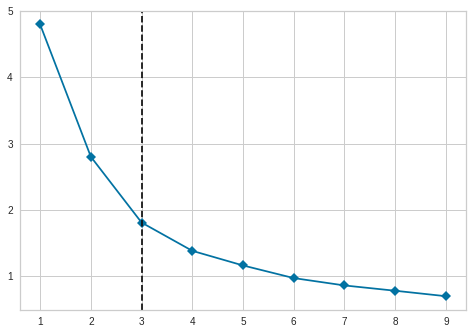

In [ ]:
# KElbowVisualizer library allows us to perform kMeans clustering with a range of k in a one-liner code.
!pip install -U yellowbrick
from yellowbrick.cluster import KElbowVisualizer

selangor_grouped_clustering = selangor_grouped.drop('Town', 1)

model = KMeans(random_state=0)
visualizer = KElbowVisualizer(model, k=(1,10), timings=False)
visualizer.fit(selangor_grouped_clustering)


As pointed out by the plotted line on the graph above, k = 3 is the optimum number of cluster. Knowing k = 3, we can perform then proceed to perform kMeans clustering on our data set to categorize our towns into THREE (3) distinct labels.

In [ ]:
# Set number of clusters
kclusters = 3

# Run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(selangor_grouped_clustering)

# Check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10]

array([1, 1, 1, 0, 0, 0, 1, 1, 1, 1], dtype=int32)

The clustering model successfully categorized our data into 3 clusters. We can now check the characteristics of each of the three clusters. Based on the restaurant type distribution, it seems like one cluster is predominantly **Chinese restaurant**; another is predominantly **Malay restaurant**; and the last cluster is predominantly **Seafood restaurant**.

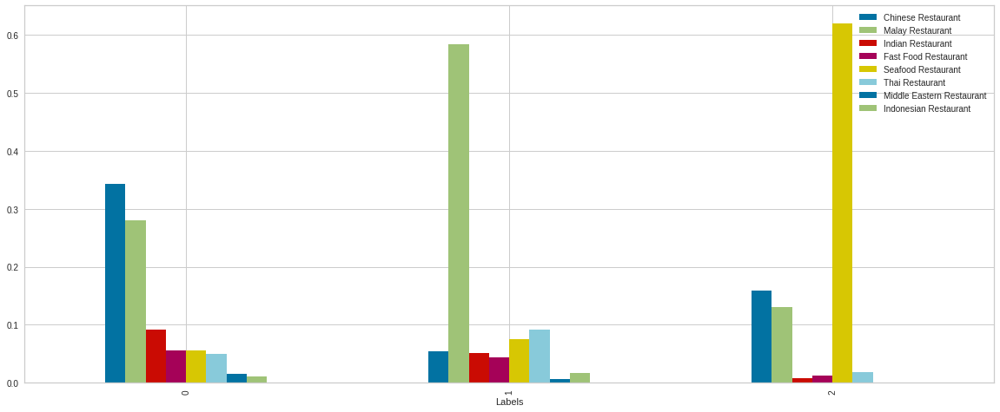

In [ ]:
# Group them by cluster labels now
selangor_grouped['Labels'] = kmeans.labels_
top_n = 8

topN = selangor_grouped.groupby('Labels').mean().transpose().nlargest(top_n,0).transpose()
df_topN = pd.DataFrame(topN)
ax = df_topN.plot.bar(figsize=(20,8))

In [ ]:
# Add clustering labels
if 'Cluster Labels' in town_venues_sorted.columns:
  town_venues_sorted = town_venues_sorted.drop(['Cluster Labels'], axis=1)

town_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

selangor_merged = df_town

# Merge selangor_merged with town_venues_sorted to add latitude/longitude for each neighborhood
selangor_merged = selangor_merged.join(town_venues_sorted.set_index('Town'), on='Town')

selangor_merged.head()
selangor_merged = selangor_merged.dropna()

## Visualizing The Clusters <a name="visualizing-clusters"></a>

Finally, we can go back to our Choropleth map to plot our towns based on their cluster label. This will help us to visualize the dominant restaurant type at each town. We wouldn't want to open our Chinese restaurant at a town with predominantly Chinese restaurant because the competition will be very tough.

In [ ]:
selangor_map = folium.Map(
	location=[lat_selangor, lng_selangor],
	zoom_start=10,
	tiles='Mapbox Bright'
)

selangor_geo = r'selangor_geofile.json'

selangor_map.choropleth(
	geo_data=selangor_geo,
	data=df_town_merged,
	columns=['District', 'Population'],
	key_on='feature.properties.ADM2_EN',
	fill_color='YlOrRd',
	legend_name='Population in Selangor'
)

# Set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# # implement switch-case statement in python
# def clusterSwitchStatement(i):
#  switcher={
#          0:'Malay Restaurant',
#          1:'Chinese Restaurant',
#          2:'Seafood Restaurant'
#        }
#  return switcher.get(i,"Invalid cluster label.")

# Add markers to the map
markers_colors = []
for lat, lng, poi, cluster in zip(selangor_merged['Latitude'], selangor_merged['Longitude'], selangor_merged['Town'], selangor_merged['Cluster Labels']):
  # clusterName = clusterSwitchStatement(cluster)
  label = folium.Popup(str(poi) + ', Cluster: "' + str(cluster) + '"', parse_html=True)
  folium.CircleMarker(
      [lat, lng],
      radius=5,
      popup=label,
      color=rainbow[int(cluster-1)],
      fill=True,
      fill_color=rainbow[int(cluster-1)],
      fill_opacity=0.7).add_to(selangor_map)
      
selangor_map

/usr/local/lib/python3.6/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


As a final touch, we can also change the marker size based on the number of restaurants in each town. This is because all restaurants regardless of cuisine type is still competing with our stakeholder's Chinese Restaurant. It's a good idea to pick a town where there are lesser Chinese restaurant, as well as lesser restaurant count but high population density.

In [ ]:
selangor_map = folium.Map(
	location=[lat_selangor, lng_selangor],
	zoom_start=10,
	tiles='Mapbox Bright'
)

selangor_geo = r'selangor_geofile.json'

selangor_map.choropleth(
	geo_data=selangor_geo,
	data=df_town_merged,
	columns=['District', 'Population'],
	key_on='feature.properties.ADM2_EN',
	fill_color='YlOrRd',
	legend_name='Population in Selangor'
)

# Set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

df_town_merged = df_town_merged.fillna(0)

# Add markers to the map
markers_colors = []
for lat, lng, poi, cluster in zip(selangor_merged['Latitude'], selangor_merged['Longitude'], selangor_merged['Town'], selangor_merged['Cluster Labels']):
  #clusterName = clusterSwitchStatement(cluster)
  label = folium.Popup(str(poi) + ', Cluster: "' + str(cluster) + '"', parse_html=True)
  folium.CircleMarker(
      [lat, lng],
      radius=df_town_merged.loc[df_town_merged['Town'] == poi]['Total Restaurant Count'].values[0] / 10,
      popup=label,
      color=rainbow[int(cluster-1)],
      fill=True,
      fill_color=rainbow[int(cluster-1)],
      fill_opacity=0.7).add_to(selangor_map)
      
selangor_map

/usr/local/lib/python3.6/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


# Results and Discussion <a name="results"></a>

Our analysis shows that there is a great number of restaurants in Selangor. That's ~2500 to 3000 restaurants in just 2.5km radius of each town, and that's not even the full list because it was hardcapped by Foursquare's API query limit. Unsurprisingly, highest concentration of restaurants was detected close to the city center, specifically Petaling and Cheras district which makes sense because these areas are known to be populated primarily by Chinese.

What we like to see is **non-red dots** that are **small** and located in a **red color** district. These attributes implies that there are pockets of low restaurant density fairly close to city center such as Subang Airport, Kajang, Ampang and Hulu Langat. 

These towns fulfill all of the criterias that we have listed out at the start of this report. They are...
* located in relatively dense district in Selangor, 
* have low restaurant count in a 2.5km around the town, ergo less competition.
* are clustered as predominantly Malay restaurant.

In other words, these towns are the most promising location candidates for stakeholders to open up new Chinese restaurant.

However, it's important to note that these recommended zones is just a starting point for us to prompt further investigation because there are a multitude of important factors that was not taken into consideration. These includes attractiveness of each location, levels of noise / proximity to major roads, real estate availability, prices, social and economic dynamics of neighborhoods, etc, all of which can make or break the deal. Perhaps, these factors can be incorporated into our analysis in the future.